# Bike Sharing Demand - Data Exploration and Visualization

### Overview  <br>
Bike sharing systems are a means of renting bicycles where the process of obtaining membership, rental, and bike return is automated via a network of kiosk locations throughout a city. Using these systems, people are able rent a bike from a one location and return it to a different place on an as-needed basis. Currently, there are over 500 bike-sharing programs around the world.

The data generated by these systems makes them attractive for researchers because the duration of travel, departure location, arrival location, and time elapsed is explicitly recorded. Bike sharing systems therefore function as a sensor network, which can be used for studying mobility in a city. 

### Objective <br>
Combine historical usage patterns with weather data in order to forecast bike rental demand in the Capital Bikeshare program in Washington, D.C.

### Data Description <br>

Hourly rental data spanning two years are provided. The training set is comprised of the first 19 days of each month, while the test set is the 20th to the end of the month. You must predict the total count of bikes rented during each hour covered by the test set, using only information available prior to the rental period.

### Data Fields <br>
datetime - hourly date + timestamp  <br>
season -  1 = spring, 2 = summer, 3 = fall, 4 = winter <br>
holiday - whether the day is considered a holiday <br>
workingday - whether the day is neither a weekend nor holiday <br>
weather - 1: Clear, Few clouds, Partly cloudy, Partly cloudy
2: Mist + Cloudy, Mist + Broken clouds, Mist + Few clouds, Mist
3: Light Snow, Light Rain + Thunderstorm + Scattered clouds, Light Rain + Scattered clouds
4: Heavy Rain + Ice Pallets + Thunderstorm + Mist, Snow + Fog <br>
temp - temperature in Celsius <br>
atemp - "feels like" temperature in Celsius <br>
humidity - relative humidity <br>
windspeed - wind speed <br>
casual - number of non-registered user rentals initiated <br>
registered - number of registered user rentals initiated <br>
count - number of total rentals <br>



In [32]:
# Importing the libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline 
# Ignore useless warnings (see SciPy issue #5998)
import warnings
warnings.filterwarnings(action="ignore", message="^internal gelsd")

import scipy.stats as stats
from scipy import stats
from scipy.stats import pointbiserialr, spearmanr, skew, pearsonr

In [2]:
# Importing the datas
train_data = pd.read_csv('./Data/train.csv')
test_data = pd.read_csv('./Data/test.csv')


## Data Exploration

### Data Description
datetime - hourly date + timestamp <br>  
season -  1 = spring, 2 = summer, 3 = fall, 4 = winter <br>
holiday - whether the day is considered a holiday <br>
workingday - whether the day is neither a weekend nor holiday <br>
weather - 1: Clear, Few clouds, Partly cloudy, Partly cloudy
2: Mist + Cloudy, Mist + Broken clouds, Mist + Few clouds, Mist
3: Light Snow, Light Rain + Thunderstorm + Scattered clouds, Light Rain + Scattered clouds
4: Heavy Rain + Ice Pallets + Thunderstorm + Mist, Snow + Fog <br>
temp - temperature in Celsius <br>
atemp - "feels like" temperature in Celsius <br>
humidity - relative humidity <br>
windspeed - wind speed <br>
casual - number of non-registered user rentals initiated <br>
registered - number of registered user rentals initiated <br>
count - number of total rentals <br>

In [3]:
train_data.head()

,datetime,season,holiday,workingday,weather,temp,atemp,humidity,windspeed,casual,registered,count
0,2011-01-01 00:00:00,1,0,0,1,9.84,14.395,81,0.0,3,13,16
1,2011-01-01 01:00:00,1,0,0,1,9.02,13.635,80,0.0,8,32,40
2,2011-01-01 02:00:00,1,0,0,1,9.02,13.635,80,0.0,5,27,32
3,2011-01-01 03:00:00,1,0,0,1,9.84,14.395,75,0.0,3,10,13
4,2011-01-01 04:00:00,1,0,0,1,9.84,14.395,75,0.0,0,1,1


In [4]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10886 entries, 0 to 10885
Data columns (total 12 columns):
datetime      10886 non-null object
season        10886 non-null int64
holiday       10886 non-null int64
workingday    10886 non-null int64
weather       10886 non-null int64
temp          10886 non-null float64
atemp         10886 non-null float64
humidity      10886 non-null int64
windspeed     10886 non-null float64
casual        10886 non-null int64
registered    10886 non-null int64
count         10886 non-null int64
dtypes: float64(3), int64(8), object(1)
memory usage: 1020.7+ KB


Feature type: <br>
datetime - datetime <br>
numerical = temp, atemp, humidity, windspeed, casual, registered, count <br>
categorical = season, holiday, working day, weather <br>  

In [5]:
# Check for duplicates
train_data.drop_duplicates(subset=None, keep='first', inplace=True);

In [6]:
train_data['datetime'] = pd.to_datetime(train_data['datetime'])

In [7]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10886 entries, 0 to 10885
Data columns (total 12 columns):
datetime      10886 non-null datetime64[ns]
season        10886 non-null int64
holiday       10886 non-null int64
workingday    10886 non-null int64
weather       10886 non-null int64
temp          10886 non-null float64
atemp         10886 non-null float64
humidity      10886 non-null int64
windspeed     10886 non-null float64
casual        10886 non-null int64
registered    10886 non-null int64
count         10886 non-null int64
dtypes: datetime64[ns](1), float64(3), int64(8)
memory usage: 1.1 MB


Need to change the categorical columns from integer to categorical variable
season, weather

In [8]:
# Mapping Season
train_data['season'] = train_data.season.map({1: "Spring", 2 : "Summer", 3 : "Fall", 4 :"Winter" })

In [9]:
# Mapping Weather
train_data['weather'] = train_data.weather.map({1: "Clear", 2: "Cloudy", 3: "Light Rain", 4: "Heavy Rain"})

In [10]:
train_data.head(10)

,datetime,season,holiday,workingday,weather,temp,atemp,humidity,windspeed,casual,registered,count
0,2011-01-01 00:00:00,Spring,0,0,Clear,9.84,14.395,81,0.0000,3,13,16
1,2011-01-01 01:00:00,Spring,0,0,Clear,9.02,13.635,80,0.0000,8,32,40
2,2011-01-01 02:00:00,Spring,0,0,Clear,9.02,13.635,80,0.0000,5,27,32
3,2011-01-01 03:00:00,Spring,0,0,Clear,9.84,14.395,75,0.0000,3,10,13
4,2011-01-01 04:00:00,Spring,0,0,Clear,9.84,14.395,75,0.0000,0,1,1
5,2011-01-01 05:00:00,Spring,0,0,Cloudy,9.84,12.880,75,6.0032,0,1,1
6,2011-01-01 06:00:00,Spring,0,0,Clear,9.02,13.635,80,0.0000,2,0,2
7,2011-01-01 07:00:00,Spring,0,0,Clear,8.20,12.880,86,0.0000,1,2,3
8,2011-01-01 08:00:00,Spring,0,0,Clear,9.84,14.395,75,0.0000,1,7,8
9,2011-01-01 09:00:00,Spring,0,0,Clear,13.12,17.425,76,0.0000,8,6,14


In [11]:
# Extract year, month, day, hour from the datetime data
train_data['year'] = train_data['datetime'].dt.year
train_data['month'] = train_data['datetime'].dt.month
train_data['day'] = train_data['datetime'].dt.day
train_data['hour'] = train_data['datetime'].dt.hour
train_data['day_of_week'] = train_data['datetime'].dt.dayofweek

In [12]:
train_data['day_of_week'] = train_data.day_of_week.map({0: "Monday", 1: "Tuesday", 2: "Wednesday", 3: "Thursday", 4: "Friday", 5: "Saturday", 6: "Sunday" })

In [13]:
train_data.head()

,datetime,season,holiday,workingday,weather,temp,atemp,humidity,windspeed,casual,registered,count,year,month,day,hour,day_of_week
0,2011-01-01 00:00:00,Spring,0,0,Clear,9.84,14.395,81,0.0,3,13,16,2011,1,1,0,Saturday
1,2011-01-01 01:00:00,Spring,0,0,Clear,9.02,13.635,80,0.0,8,32,40,2011,1,1,1,Saturday
2,2011-01-01 02:00:00,Spring,0,0,Clear,9.02,13.635,80,0.0,5,27,32,2011,1,1,2,Saturday
3,2011-01-01 03:00:00,Spring,0,0,Clear,9.84,14.395,75,0.0,3,10,13,2011,1,1,3,Saturday
4,2011-01-01 04:00:00,Spring,0,0,Clear,9.84,14.395,75,0.0,0,1,1,2011,1,1,4,Saturday


In [14]:
train_data.describe()

,holiday,workingday,temp,atemp,humidity,windspeed,casual,registered,count,year,month,day,hour
count,10886.000000,10886.000000,10886.00000,10886.000000,10886.000000,10886.000000,10886.000000,10886.000000,10886.000000,10886.000000,10886.000000,10886.000000,10886.000000
mean,0.028569,0.680875,20.23086,23.655084,61.886460,12.799395,36.021955,155.552177,191.574132,2011.501929,6.521495,9.992559,11.541613
std,0.166599,0.466159,7.79159,8.474601,19.245033,8.164537,49.960477,151.039033,181.144454,0.500019,3.444373,5.476608,6.915838
min,0.000000,0.000000,0.82000,0.760000,0.000000,0.000000,0.000000,0.000000,1.000000,2011.000000,1.000000,1.000000,0.000000
25%,0.000000,0.000000,13.94000,16.665000,47.000000,7.001500,4.000000,36.000000,42.000000,2011.000000,4.000000,5.000000,6.000000
50%,0.000000,1.000000,20.50000,24.240000,62.000000,12.998000,17.000000,118.000000,145.000000,2012.000000,7.000000,10.000000,12.000000
75%,0.000000,1.000000,26.24000,31.060000,77.000000,16.997900,49.000000,222.000000,284.000000,2012.000000,10.000000,15.000000,18.000000
max,1.000000,1.000000,41.00000,45.455000,100.000000,56.996900,367.000000,886.000000,977.000000,2012.000000,12.000000,19.000000,23.000000


In [15]:
# Categorical variables
cat_var = ['season', 'holiday', 'workingday', 'weather','year', 'month', 'day', 'hour', 'day_of_week']

In [16]:
# changing datatype as category
train_data[cat_var].astype("category");

In [17]:
#Numerical variables
num_var = ['temp', 'atemp', 'humidity', 'windspeed', 'casual', 'registered', 'count']

In [18]:
# Missing values
train_data.sum()[train_data.isnull().sum() > 0]

Series([], dtype: float64)

No missing values

### Univariate analysis

#### Histogram

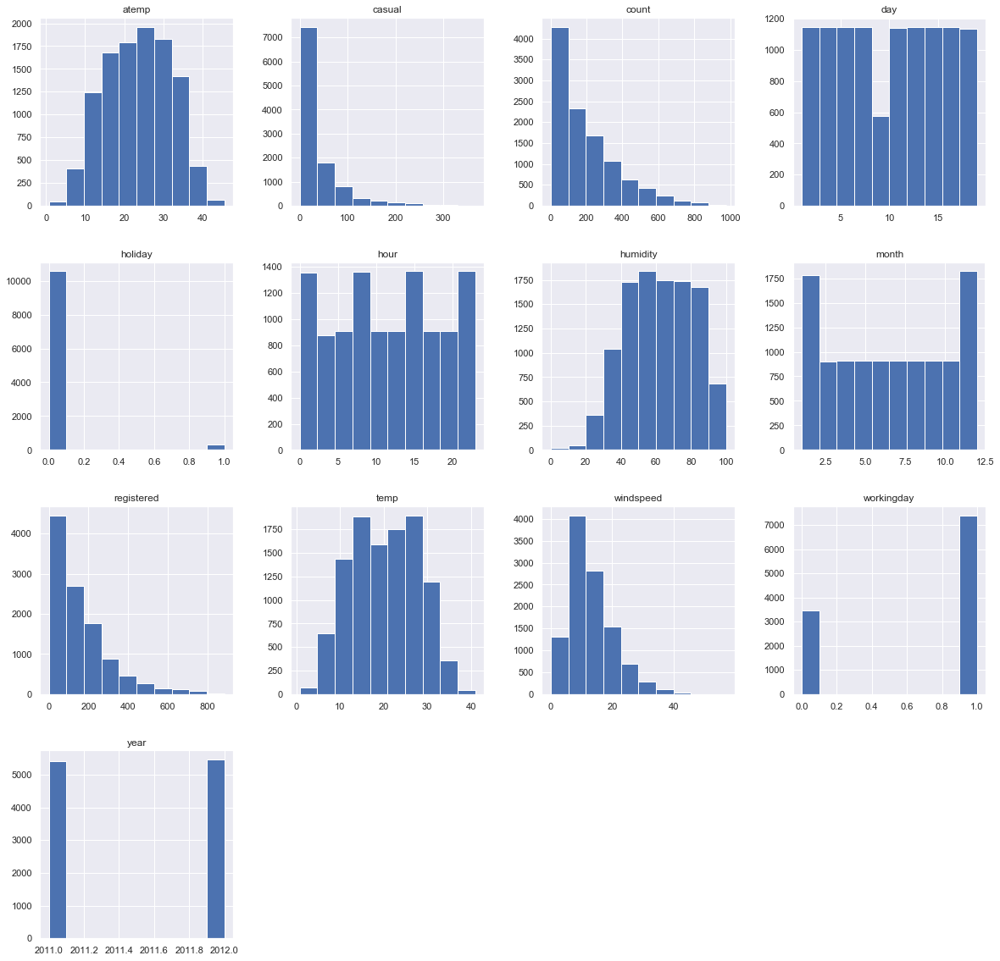

In [100]:
# Histogram
sns.set()
train_data.hist(figsize=(20,20));

Observations: 1) Counts (both casual and registered) strongly right skewed. 2) Temp and atemp are roughly normally distrubuted. 3) Day count shows a dip near day 10. 4) Hours show multimodal distribution. 5) Humidity shows left skewed. 6) Month show bimodal - dominated by 1 and 12  7) working day counts dominates over holiday
 

#### Boxplot and Violinplot

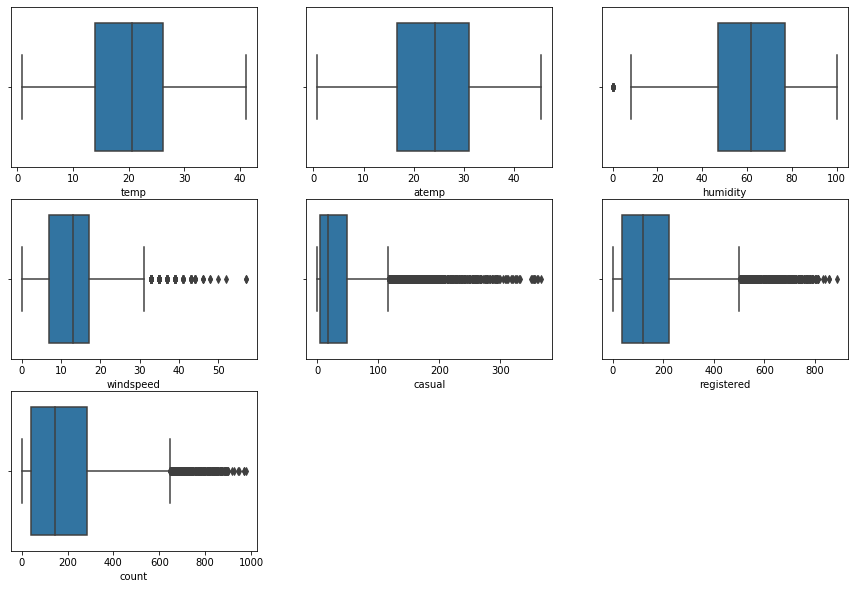

In [20]:
plt.subplots(figsize=(15, 10))
plt.tight_layout
for k,i in enumerate(num_var):
    plt.subplot(3,3,k+1)
    sns.boxplot(x = i, data = train_data)

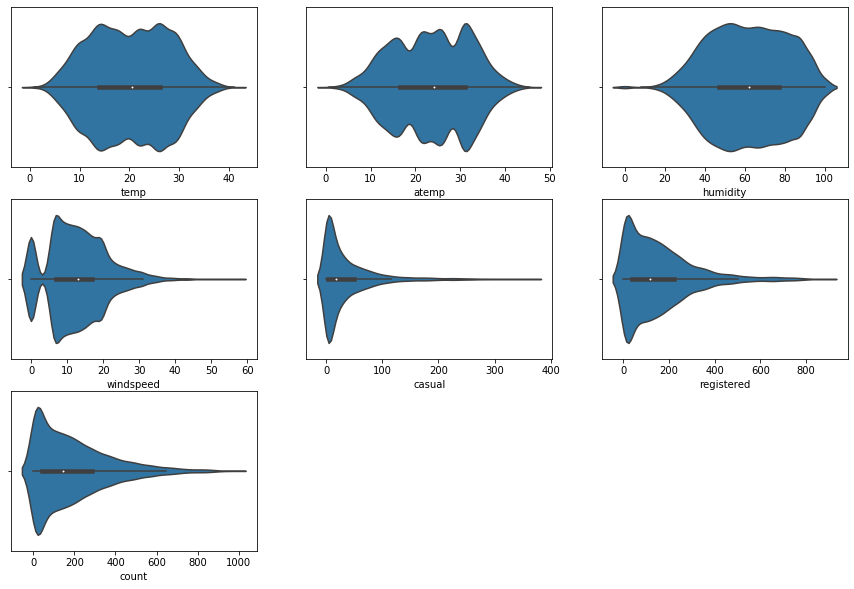

In [21]:
plt.subplots(figsize=(15, 10))
plt.tight_layout
for k,i in enumerate(num_var):
    plt.subplot(3,3,k+1)
    sns.violinplot(x = i, data = train_data)

Humidity has one outlier value. windspeed, count has many readings beyond (right) the quartile range - rightskew
From violin plot - windspeed has a small hump close to zero and a larger hump. 

### Categorical variable

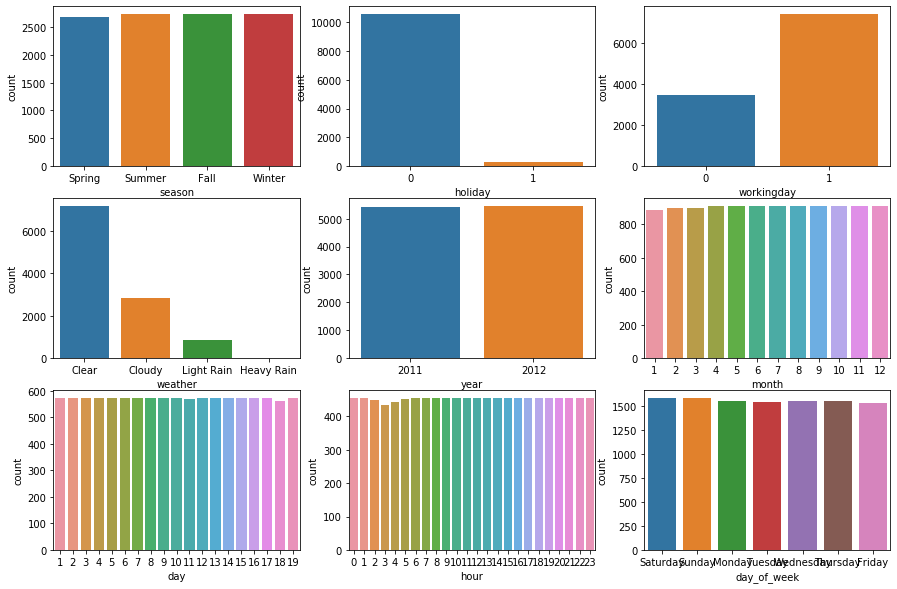

In [22]:
plt.subplots(figsize=(15, 10))
plt.tight_layout
for k,i in enumerate(cat_var):
    plt.subplot(3,3,k+1)
    sns.countplot(x = i, data = train_data)

### Bivariate analysis

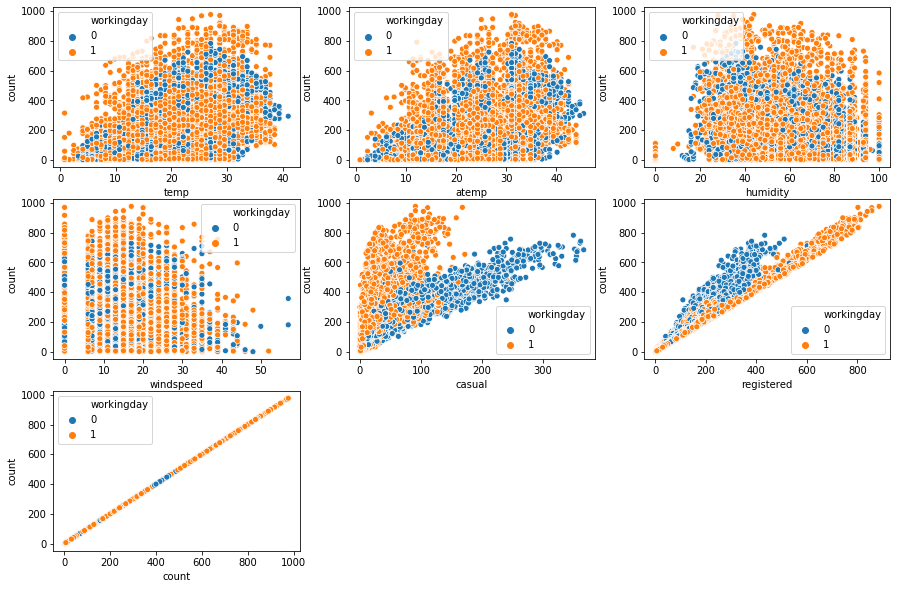

In [97]:
plt.subplots(figsize=(15, 10))
plt.tight_layout
for k,i in enumerate(num_var):
    plt.subplot(3,3,k+1)
    sns.scatterplot(x = i, y = 'count', data = train_data, hue= 'workingday')

overall count dominated by workingday. Casual dominates in holidays while registered dominates workingday. 

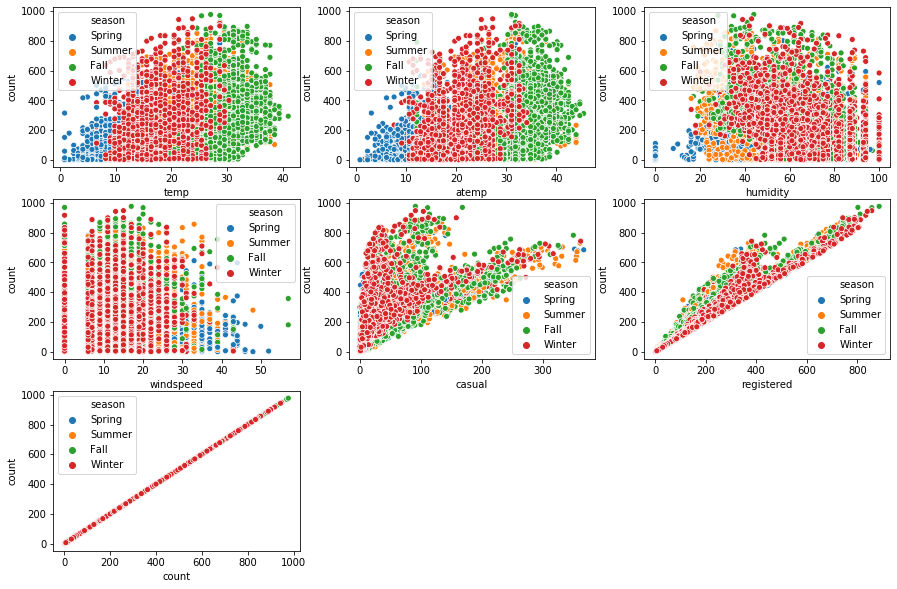

In [98]:
plt.subplots(figsize=(15, 10))
plt.tight_layout
for k,i in enumerate(num_var):
    plt.subplot(3,3,k+1)
    sns.scatterplot(x = i, y = 'count', data = train_data, hue= 'season')

Distinct dependence of temp, atemp, humidity on seasons. Winter has distinct lower count for casual. For registered no such differences.

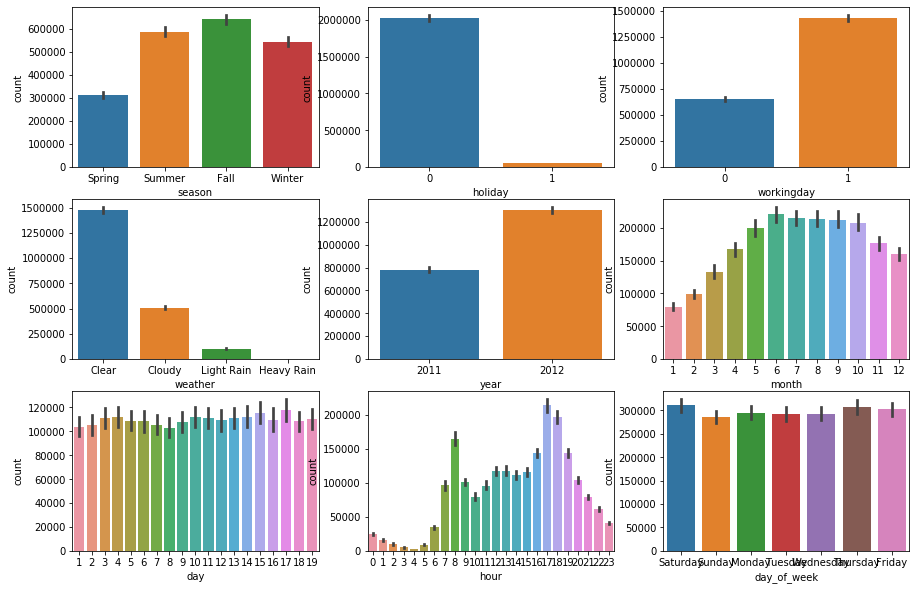

In [24]:
plt.subplots(figsize=(15, 10))
plt.tight_layout
for k,i in enumerate(cat_var):
    plt.subplot(3,3,k+1)
    sns.barplot(x = i, y = 'count', data = train_data, estimator=sum)

seasons - Fall has maximum, slightly more that summer and winter. Spring is distinctly smaller. <br>
workingday counts is distinctly larger than holidays. <br>
weather - Largest (significantly) for clear. Smaller for cloudy. Very small for light rain. Practically nil for heavy rain.<br>
year - 2012 has larger counts than 2011 - Upwards trend with time- Also can be seen in the timeseries.<br>
months 6-10 largest ( corresponding to the fall season). Months are correlated with the seasons.<br>
no preference for day of month.<br>
hours: 1st peak at 8 with 7-9 high (corresponding to office). Highest peak at 17-18 (home return). Would be interesting to see how hours corresponds to workingday/holidays.<br>

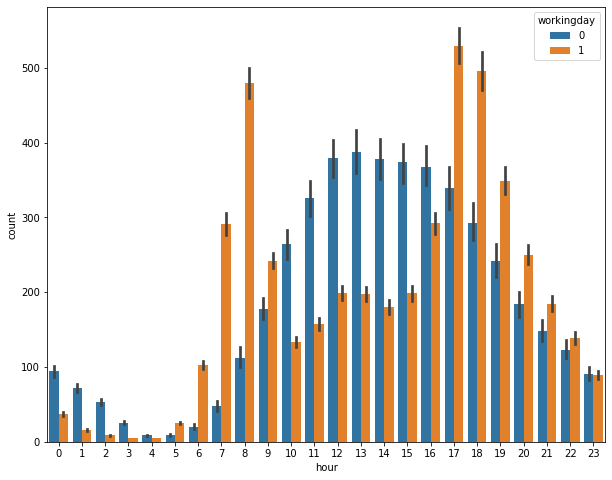

In [93]:
plt.subplots(figsize=(10, 8))
sns.barplot(x = 'hour', y = 'count' , data = train_data, hue = 'workingday')

Clearly the time 6-9 & 17-20 dominates on workingdays. For holidays, the midday and afternoon period (10-16) dominant.

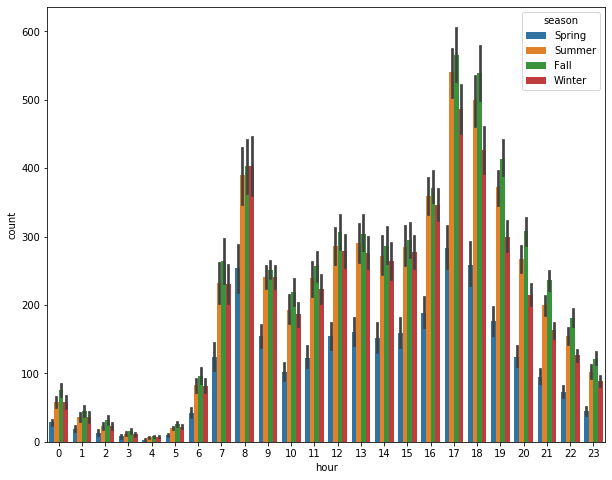

In [99]:
plt.subplots(figsize=(10, 8))
sns.barplot(x = 'hour', y = 'count' , data = train_data, hue = 'season')

In [25]:
train_data.groupby('season').sum()

,holiday,workingday,temp,atemp,humidity,windspeed,casual,registered,count,year,month,day,hour
season,,,,,,,,,,,,,
Fall,96,1845,78680.64,88933.960,175250,31453.7195,142718,497944,640662,5497431,21861,27334,31458
Spring,71,1828,33656.90,40904.975,151216,39314.9233,41605,270893,312498,5402909,5389,26776,31272
Summer,48,1893,62376.58,72826.520,166311,36637.5229,129672,458610,588282,5497429,13668,27336,31454
Winter,96,1846,45519.02,54843.790,180919,31928.0527,78140,465894,544034,5499441,30075,27333,31458


#### Time-series plot

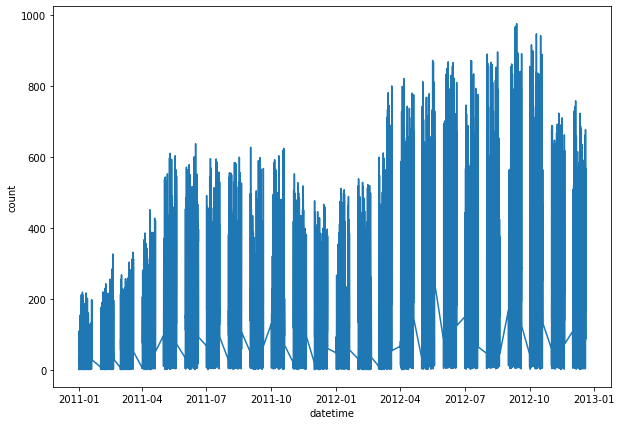

In [26]:
plt.figure(figsize=(10,7))
sns.lineplot(x = 'datetime', y = 'count', data = train_data);

### Correlations

In [27]:
corr_matrix = train_data.corr()

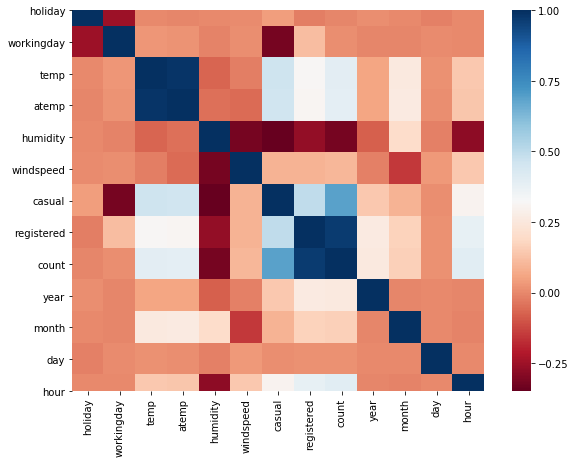

In [28]:
plt.subplots(figsize=(10, 7))
sns.heatmap(corr_matrix, vmax=1, cmap="RdBu", square=True);

Strong correlation between temp and atemp - multicollinearity. Can select any one. 

The pearson correlation is only for numerical variable. To find categorical variable correlation we must use spearman correlation

In [73]:
# Defining spearman correlation for all variables
def corr_spr(dataframe):
    mat = []
    for i in dataframe.columns:
        for j in dataframe.columns:
            mat.append(spearmanr(dataframe[i], dataframe[j])[0])
    return mat
    

In [79]:
# list of spearman correlation values
corr_spr_list = corr_spr(train_data.iloc[:,1:])

In [84]:
#converting spearman correlation values into dataframe
corr_spr_mat = pd.DataFrame(np.array(corr_spr_list).reshape(16,16), columns = train_data.iloc[:,1:].columns, index=train_data.iloc[:,1:].columns)

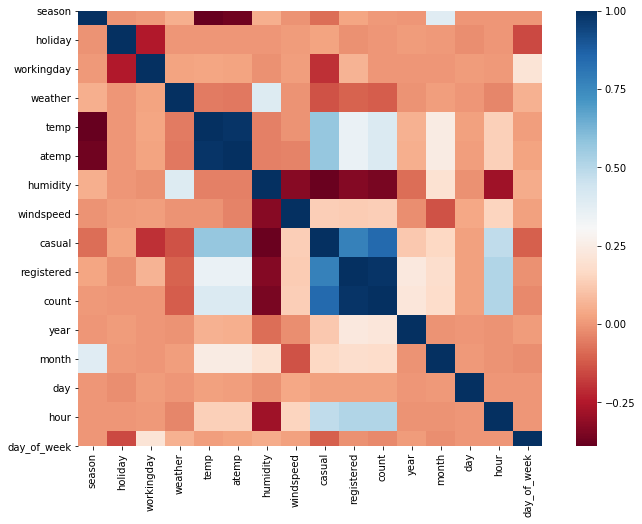

In [87]:
plt.subplots(figsize=(12, 8))
sns.heatmap(corr_spr_mat, vmax=1, cmap="RdBu", square=True);

correlation between <br>
season and temp, atemp, month - expected.<br>
holiday, working day with day of the week.<br>
working day and casual (negative) - in working day less casual biking<br>
weather, temp has influence on casual, registered and counts<br>
humidity - strong association with weather, windspeed, count, and hours<br>